# <i><font color='green'><a id='the_destination_2'> 2) <u>Data Collection and Exploration</u>: </a></font></i>

In [1]:
import osmnx as ox
import pandas as pd
import folium
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import Point, Polygon, MultiPolygon, shape
import plotly.express as px
import plotly.offline as pyo
import pyproj
import geopandas as gpd
import warnings

# Set up Plotly to work in offline mode
pyo.init_notebook_mode(connected=True)

In [2]:
# Get the coordinates for Dublin, Ireland
location = ox.geocode('Dublin, Ireland')

In [3]:
print("The coordinates for Dublin city centre is", location)

The coordinates for Dublin city centre is (53.3493795, -6.2605593)


## <a id='the_destination_2_1'>a) Potential Hotspot Locations in Dublin</a>

In [4]:
# Use OpenStreetMaps library to get all the hotspots within a specified distance
distance = 20000  # Radius of 20 kilometers around the location
tags = {'amenity': True}
gdf = ox.geometries_from_point(location, tags=tags, dist=distance)

C:\Users\196sh\AppData\Local\Temp\ipykernel_21384\4114702718.py:4: UserWarning:

The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.



In [5]:
gdf.head()

barrier bicycle foot horse motorcar motorcycle  \
element_type osmid                                                     
node         12244654     NaN     NaN  NaN   NaN      NaN        NaN   
             26452895     NaN     NaN  NaN   NaN      NaN        NaN   
             27474191     NaN     NaN  NaN   NaN      NaN        NaN   
             27474239     NaN     NaN  NaN   NaN      NaN        NaN   
             28851055     NaN     NaN  NaN   NaN      NaN        NaN   

                                        geometry            addr:street  \
element_type osmid                                                        
node         12244654  POINT (-6.41780 53.38335)         Clonsilla Road   
             26452895  POINT (-6.40512 53.37260)                    NaN   
             27474191  POINT (-6.39116 53.39073)  Blanchardstown Centre   
             27474239  POINT (-6.39183 53.39096)                    NaN   
             28851055  POINT (-6.30699 53.39947)             North Road   

                                amenity       brand  ... truck_wash heating  \
element_type osmid                                   ...                      
node         12244654              fuel  Applegreen  ...        NaN     NaN   
             26452895  parking_entrance         NaN  ...        NaN     NaN   
             27474191           library         NaN  ...        NaN     NaN   
             27474239           theatre         NaN  ...        NaN     NaN   
             28851055              fuel    Circle K  ...        NaN     NaN   

                      website:en access:conditional access:note  \
element_type osmid                                                
node         12244654        NaN                NaN         NaN   
             26452895        NaN                NaN         NaN   
             27474191        NaN                NaN         NaN   
             27474239        NaN                NaN         NaN   
             28851055        NaN                NaN         NaN   

                      recycling:small_electrical_appliances  \
element_type osmid                                            
node         12244654                                   NaN   
             26452895                                   NaN   
             27474191                                   NaN   
             27474239                                   NaN   
             28851055                                   NaN   

                      recycling:tetrapak recycling:textiles ways fee:covid19  
element_type osmid                                                            
node         12244654                NaN                NaN  NaN         NaN  
             26452895                NaN                NaN  NaN         NaN  
             27474191                NaN                NaN  NaN         NaN  
             27474239                NaN                NaN  NaN         NaN  
             28851055                NaN                NaN  NaN         NaN  

[5 rows x 662 columns]

In [6]:
gdf.shape

(32025, 662)

In [7]:
gdf['amenity'].unique()

array(['fuel', 'parking_entrance', 'library', 'theatre', 'parking',
       'restaurant', 'recycling', 'post_office', 'post_box', 'atm', 'pub',
       'vending_machine', 'post_depot', 'fast_food', 'pharmacy', 'police',
       'nursing_home', 'telephone', 'waste_basket', 'toilets', 'bank',
       'taxi', 'cinema', 'social_facility', 'place_of_worship',
       'community_centre', 'bicycle_parking', 'fountain', 'nightclub',
       'cafe', 'arts_centre', 'bar', 'drinking_water', 'events_venue',
       'kindergarten', 'childcare', 'coast_guard', 'bench', 'veterinary',
       'dentist', 'shelter', 'waste_disposal', 'clock', 'bicycle_rental',
       'marketplace', 'college', 'car_wash', 'car_rental', 'studio',
       'doctors', 'driving_school', 'school', 'internet_cafe', 'casino',
       'ferry_terminal', 'ice_cream', 'research_institute', 'clinic',
       'weighbridge', 'ticket_validator', 'parking_space',
       'internet_access', 'hospital', 'charging_station', 'bbq',
       'car_sharing',

In [8]:
hotspot_tags = ['fuel', 'parking', 'events_venue', 'college', 'hospital', 
                'university', 'food_court', 'exhibition_centre', 'townhall', 'stadium', 'conference_centre']

In [9]:
# Filter the data for the hotspots in the same 25 Km radius
hotspots = gdf[gdf['amenity'].isin(hotspot_tags)]

In [10]:
hotspots.shape

(7039, 662)

In [11]:
hotspots = pd.DataFrame(hotspots)

# Remove all the columns which have less than 10% of the records populated
selected_columns = hotspots.columns[hotspots.count() > 0.1*len(hotspots)]
hotspots = hotspots[selected_columns]

In [12]:
hotspots.shape

(7039, 9)

In [13]:
hotspots.head()

geometry  amenity        name access  \
element_type osmid                                                             
node         12244654  POINT (-6.41780 53.38335)     fuel  Applegreen    NaN   
             28851055  POINT (-6.30699 53.39947)     fuel    Circle K    NaN   
             29403586  POINT (-6.29177 53.17470)  parking         NaN    yes   
             84881614  POINT (-6.24705 53.25363)  parking         NaN    NaN   
             88362015  POINT (-6.19803 53.48678)     fuel    Circle K    NaN   

                       fee  parking capacity surface nodes  
element_type osmid                                          
node         12244654  NaN      NaN      NaN     NaN   NaN  
             28851055  NaN      NaN      NaN     NaN   NaN  
             29403586   no  surface      NaN     NaN   NaN  
             84881614  NaN      NaN      NaN     NaN   NaN  
             88362015  NaN      NaN      NaN     NaN   NaN

In [14]:
# Creating separate columns for the latitude and longitude
hotspots['hotspot_latitude'] = hotspots['geometry'].apply(lambda point: point.y if isinstance(point, Point) else point.centroid.y)
hotspots['hotspot_longitude'] = hotspots['geometry'].apply(lambda point: point.x if isinstance(point, Point) else point.centroid.x)

In [15]:
# Pick only the features/columns which will be useful for our analysis 
hotspots_final = hotspots[['hotspot_latitude', 'hotspot_longitude', 'amenity', 'name']]

In [16]:
# Rename the column names for downstream use
hotspots_final = hotspots_final.rename(columns={'amenity': 'hotspot_tag', 
                                                'name': 'hotspot_location'})

In [17]:
print("The total number of potential hotspots considered for our analysis is", len(hotspots_final))

The total number of potential hotspots considered for our analysis is 7039


In [18]:
hotspots_final.reset_index(drop=True).head()

,hotspot_latitude,hotspot_longitude,hotspot_tag,hotspot_location
0,53.383351,-6.417798,fuel,Applegreen
1,53.399470,-6.306985,fuel,Circle K
2,53.174703,-6.291769,parking,NaN
3,53.253626,-6.247051,parking,NaN
4,53.486778,-6.198035,fuel,Circle K


In [19]:
# Get the counts of each hotspot category
category_counts = hotspots_final['hotspot_tag'].value_counts()

C:\Users\196sh\anaconda3\lib\site-packages\seaborn\rcmod.py:400: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

C:\Users\196sh\anaconda3\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



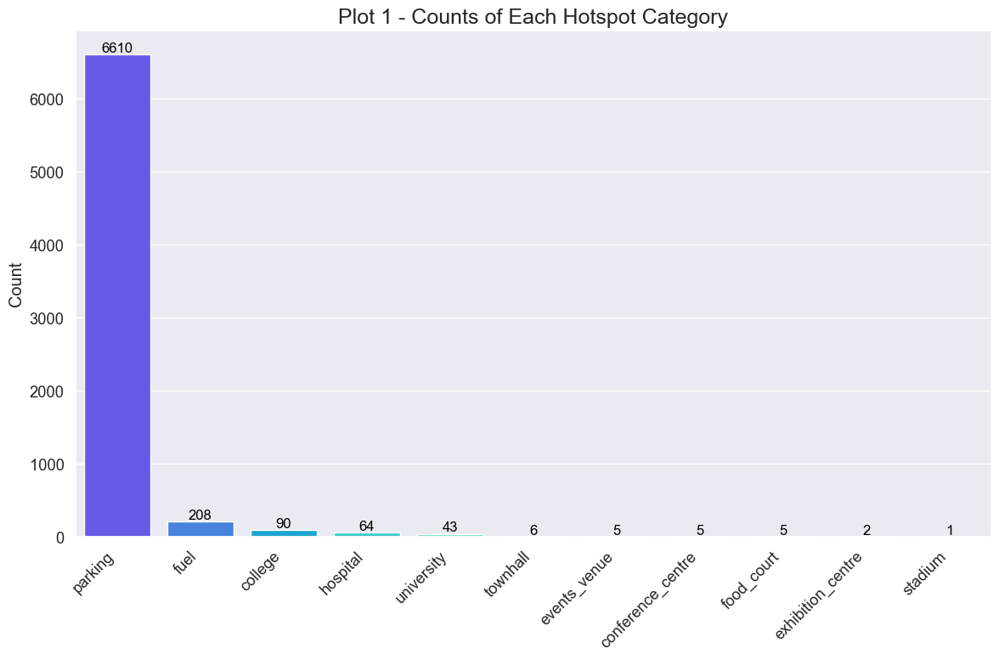

In [20]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Create a bar plot using Seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x=category_counts.index, y=category_counts, palette='rainbow')

# Add count labels on top of each bar
for index, value in enumerate(category_counts):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12, color='black')

plt.ylabel('Count')
plt.title('Plot 1 - Counts of Each Hotspot Category', fontsize=18)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [21]:
# Create a map centered around Dublin
latitude = location[0]  # Latitude of the center point
longitude = location[1] # Longitude of the center point
map_osm = folium.Map(location=[latitude, longitude], zoom_start=12)
# icon = folium.Icon(icon='circle', prefix='fa', color='blue', icon_color='white', icon_size=(4, 4))

# Add markers for each potential hotspot
for index, spot in hotspots_final.iterrows():
    name = spot['hotspot_location']
    lat = spot['hotspot_latitude']
    lon = spot['hotspot_longitude']
    marker = folium.CircleMarker(location=[lat, lon], radius=4, popup=name, color='green', fill=True, fill_color='green')
    marker.add_to(map_osm)

# Display the map
map_osm

### <div style="text-align: right">[Back to top ↑](#top)</div>

## <a id='the_destination_2_2'>b) Existing Electric Vehicle Charging Station Locations in Dublin</a>

In [22]:
def get_charging_stations(latitude, longitude, radius, api_key):
    url = f"https://api.openchargemap.io/v3/poi/?output=json&latitude={latitude}&longitude={longitude}&distance={radius}&distanceunit=KM&maxresults=300&&verbose=false&key={api_key}"
    
    try:
        response = requests.get(url)
        response.raise_for_status()
        data = response.json()
        return data

    except requests.exceptions.RequestException as e:
        print("Error occurred while retrieving charging station data:", e)
        return None
    except ValueError as e:
        print("Error occurred while parsing JSON response:", e)
        return None

# Dublin Center coordinates
latitude = location[0]
longitude = location[1]

# Radius in kilometers
radius = 25

# API key from OpenChargeMap
api_key = "431e2548-cd50-4959-971b-5e99539c2651"

charging_stations = get_charging_stations(latitude, longitude, radius, api_key)
charging_stations = pd.DataFrame(charging_stations)

In [23]:
len(charging_stations)

246

In [24]:
pd.set_option('display.max_columns', None)
charging_stations.head()

,DataProvider,UsageType,SubmissionStatus,IsRecentlyVerified,DateLastVerified,ID,UUID,DataProviderID,DataProvidersReference,UsageTypeID,AddressInfo,Connections,DateLastStatusUpdate,MetadataValues,DataQualityLevel,DateCreated,SubmissionStatusTypeID,OperatorInfo,StatusType,OperatorID,OperatorsReference,UsageCost,NumberOfPoints,StatusTypeID,GeneralComments,UserComments,MediaItems
0,{'WebsiteURL': 'http://chargepoints.dft.gov.uk...,"{'IsPayAtLocation': True, 'IsMembershipRequire...","{'IsLive': True, 'ID': 100, 'Title': 'Imported...",True,2023-07-04T05:45:00Z,214705,EE003D02-8575-420F-8797-C9B2D7D546C2,18,153a719109d5901f816d699f83ba381e,5.0,"{'ID': 215085, 'Title': 'The Spire Car Park 1'...","[{'ID': 357365, 'ConnectionTypeID': 25, 'Conne...",2023-07-04T05:45:00Z,"[{'ID': 22531, 'MetadataFieldID': 4, 'ItemValu...",3,2023-02-09T08:13:00Z,100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,"{'WebsiteURL': 'http://openchargemap.org', 'Da...","{'IsPayAtLocation': False, 'IsMembershipRequir...","{'IsLive': True, 'ID': 200, 'Title': 'Submissi...",False,2020-08-08T15:24:00Z,127304,672CF633-6914-4CB9-9978-731411CF78B4,1,NaN,4.0,"{'ID': 127650, 'Title': 'Q-Park The Spire Mult...","[{'ID': 178256, 'ConnectionTypeID': 25, 'Conne...",2020-08-08T15:24:00Z,NaN,1,2019-06-03T08:42:00Z,200,{'WebsiteURL': 'https://www.gocharge.ie/charge...,"{'IsOperational': True, 'IsUserSelectable': Tr...",3402.0,C8PJ7,€1 Connection Fee & €0.30 per kWh,2.0,50.0,NaN,NaN,NaN
2,"{'WebsiteURL': 'http://openchargemap.org', 'Da...","{'IsPayAtLocation': False, 'IsMembershipRequir...","{'IsLive': True, 'ID': 200, 'Title': 'Submissi...",False,2018-10-11T13:54:00Z,109200,94158280-CA4C-4187-BF49-E860D5C73A9E,1,NaN,7.0,"{'ID': 109546, 'Title': 'Cassidys Hotel', 'Add...","[{'ID': 154318, 'ConnectionTypeID': 30, 'Conne...",2018-10-11T13:54:00Z,NaN,1,2018-10-11T13:54:00Z,200,"{'WebsiteURL': 'http://www.teslamotors.com', '...","{'IsOperational': True, 'IsUserSelectable': Tr...",23.0,44550,NaN,2.0,50.0,"2 Tesla Connectors, up to 6kW.Available by res...",NaN,NaN
3,"{'WebsiteURL': 'http://openchargemap.org', 'Da...","{'IsPayAtLocation': False, 'IsMembershipRequir...","{'IsLive': True, 'ID': 100, 'Title': 'Imported...",False,2017-02-09T22:09:00Z,15102,B531CB42-F2C5-4C9A-99AD-94F6D02DEE89,1,NaN,7.0,"{'ID': 15448, 'Title': 'The Westin Dublin', 'A...","[{'ID': 91504, 'ConnectionTypeID': 25, 'Connec...",2017-02-09T22:09:00Z,NaN,2,2012-12-11T15:08:00Z,100,{'Comments': 'For use when the operator of the...,"{'IsOperational': True, 'IsUserSelectable': Tr...",45.0,The Westin Dublin,NaN,1.0,50.0,NaN,NaN,NaN
4,"{'WebsiteURL': 'http://openchargemap.org', 'Da...","{'IsPayAtLocation': False, 'IsMembershipRequir...","{'IsLive': True, 'ID': 100, 'Title': 'Imported...",False,2021-12-29T16:32:00Z,66609,CAD14D5B-7DED-4534-A10A-650354BD9C09,1,NaN,4.0,"{'ID': 66955, 'Title': 'Parnell Square West', ...","[{'ID': 92032, 'ConnectionTypeID': 25, 'Connec...",2021-12-29T16:32:00Z,NaN,1,2016-05-23T16:08:00Z,100,{'WebsiteURL': 'http://www.esb.ie/electric-car...,"{'IsOperational': True, 'IsUserSelectable': Tr...",22.0,C6WKW,NaN,2.0,50.0,NaN,NaN,NaN


Based on looking at the data, we can see that the columns 'AddressInfo' and 'Connections' contain the relevant information we need for our analysis. So we'll pick them and use them for further processing

In [25]:
address_info = charging_stations.loc[:, ['UUID', 'AddressInfo']]
connections = charging_stations.loc[:, ['UUID', 'Connections']]

In [26]:
pd.set_option('display.max_colwidth', None)
address_info.head()

,UUID,AddressInfo
0,EE003D02-8575-420F-8797-C9B2D7D546C2,"{'ID': 215085, 'Title': 'The Spire Car Park 1', 'AddressLine1': 'Marlborough Place, North City', 'Town': 'Dublin', 'Postcode': 'D01 W207', 'CountryID': 1, 'Country': {'ISOCode': 'GB', 'ContinentCode': 'EU', 'ID': 1, 'Title': 'United Kingdom'}, 'Latitude': 53.352036, 'Longitude': -6.258841, 'AccessComments': '', 'RelatedURL': 'http://blinkcharging.com/', 'Distance': 0.3166422879523016, 'DistanceUnit': 1}"
1,672CF633-6914-4CB9-9978-731411CF78B4,"{'ID': 127650, 'Title': 'Q-Park The Spire Multi-Storey Car Park', 'AddressLine1': 'Cathal Brugha Street', 'Town': 'Dublin 1', 'StateOrProvince': 'County Dublin', 'CountryID': 3, 'Country': {'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID': 3, 'Title': 'Ireland'}, 'Latitude': 53.352022, 'Longitude': -6.258432, 'AccessComments': 'Located on ground floor of car park', 'RelatedURL': 'http://www.gocharge.ie', 'Distance': 0.3259973648458451, 'DistanceUnit': 1}"
2,94158280-CA4C-4187-BF49-E860D5C73A9E,"{'ID': 109546, 'Title': 'Cassidys Hotel', 'AddressLine1': 'Cavendish Rowupper O'connell Street', 'Town': 'City Centre', 'StateOrProvince': 'Dublin', 'Postcode': 'D01 V3P6', 'CountryID': 3, 'Country': {'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID': 3, 'Title': 'Ireland'}, 'Latitude': 53.353102, 'Longitude': -6.261599, 'ContactTelephone1': '+353 1 87 80 555', 'Distance': 0.4196361137231489, 'DistanceUnit': 1}"
3,B531CB42-F2C5-4C9A-99AD-94F6D02DEE89,"{'ID': 15448, 'Title': 'The Westin Dublin', 'AddressLine1': 'The Westin Dublin, Westmoreland Street, Dublin 2', 'Town': 'Dublin', 'CountryID': 3, 'Country': {'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID': 3, 'Title': 'Ireland'}, 'Latitude': 53.345479, 'Longitude': -6.258945, 'Distance': 0.4467569281621442, 'DistanceUnit': 1}"
4,CAD14D5B-7DED-4534-A10A-650354BD9C09,"{'ID': 66955, 'Title': 'Parnell Square West', 'AddressLine1': 'Parnell Square West', 'Town': 'Dublin 1', 'StateOrProvince': 'County Dublin', 'CountryID': 3, 'Country': {'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID': 3, 'Title': 'Ireland'}, 'Latitude': 53.353218, 'Longitude': -6.264812, 'Distance': 0.5117129032594475, 'DistanceUnit': 1}"


In [27]:
connections.head()

,UUID,Connections
0,EE003D02-8575-420F-8797-C9B2D7D546C2,"[{'ID': 357365, 'ConnectionTypeID': 25, 'ConnectionType': {'FormalName': 'IEC 62196-2 Type 2', 'IsDiscontinued': False, 'IsObsolete': False, 'ID': 25, 'Title': 'Type 2 (Socket Only)'}, 'Reference': '1837-01-01', 'StatusTypeID': 50, 'StatusType': {'IsOperational': True, 'IsUserSelectable': True, 'ID': 50, 'Title': 'Operational'}, 'LevelID': 2, 'Level': {'Comments': 'Over 2 kW, usually non-domestic socket type', 'IsFastChargeCapable': False, 'ID': 2, 'Title': 'Level 2 : Medium (Over 2kW)'}, 'Amps': 32, 'Voltage': 400, 'PowerKW': 22.0, 'CurrentTypeID': 20, 'CurrentType': {'Description': 'Alternating Current - Three Phase', 'ID': 20, 'Title': 'AC (Three-Phase)'}}]"
1,672CF633-6914-4CB9-9978-731411CF78B4,"[{'ID': 178256, 'ConnectionTypeID': 25, 'ConnectionType': {'FormalName': 'IEC 62196-2 Type 2', 'IsDiscontinued': False, 'IsObsolete': False, 'ID': 25, 'Title': 'Type 2 (Socket Only)'}, 'StatusTypeID': 50, 'StatusType': {'IsOperational': True, 'IsUserSelectable': True, 'ID': 50, 'Title': 'Operational'}, 'LevelID': 2, 'Level': {'Comments': 'Over 2 kW, usually non-domestic socket type', 'IsFastChargeCapable': False, 'ID': 2, 'Title': 'Level 2 : Medium (Over 2kW)'}, 'Amps': 32, 'Voltage': 400, 'PowerKW': 22.0, 'CurrentTypeID': 20, 'CurrentType': {'Description': 'Alternating Current - Three Phase', 'ID': 20, 'Title': 'AC (Three-Phase)'}, 'Quantity': 2}]"
2,94158280-CA4C-4187-BF49-E860D5C73A9E,"[{'ID': 154318, 'ConnectionTypeID': 30, 'ConnectionType': {'IsDiscontinued': False, 'IsObsolete': False, 'ID': 30, 'Title': 'Tesla (Model S/X)'}, 'StatusTypeID': 50, 'StatusType': {'IsOperational': True, 'IsUserSelectable': True, 'ID': 50, 'Title': 'Operational'}, 'LevelID': 2, 'Level': {'Comments': 'Over 2 kW, usually non-domestic socket type', 'IsFastChargeCapable': False, 'ID': 2, 'Title': 'Level 2 : Medium (Over 2kW)'}, 'PowerKW': 6.0, 'CurrentTypeID': 10, 'CurrentType': {'Description': 'Alternating Current - Single Phase', 'ID': 10, 'Title': 'AC (Single-Phase)'}, 'Quantity': 2}]"
3,B531CB42-F2C5-4C9A-99AD-94F6D02DEE89,"[{'ID': 91504, 'ConnectionTypeID': 25, 'ConnectionType': {'FormalName': 'IEC 62196-2 Type 2', 'IsDiscontinued': False, 'IsObsolete': False, 'ID': 25, 'Title': 'Type 2 (Socket Only)'}, 'StatusTypeID': 50, 'StatusType': {'IsOperational': True, 'IsUserSelectable': True, 'ID': 50, 'Title': 'Operational'}, 'LevelID': 2, 'Level': {'Comments': 'Over 2 kW, usually non-domestic socket type', 'IsFastChargeCapable': False, 'ID': 2, 'Title': 'Level 2 : Medium (Over 2kW)'}, 'Amps': 16, 'Voltage': 230, 'PowerKW': 3.7, 'CurrentTypeID': 10, 'CurrentType': {'Description': 'Alternating Current - Single Phase', 'ID': 10, 'Title': 'AC (Single-Phase)'}, 'Quantity': 1}]"
4,CAD14D5B-7DED-4534-A10A-650354BD9C09,"[{'ID': 92032, 'ConnectionTypeID': 25, 'ConnectionType': {'FormalName': 'IEC 62196-2 Type 2', 'IsDiscontinued': False, 'IsObsolete': False, 'ID': 25, 'Title': 'Type 2 (Socket Only)'}, 'StatusTypeID': 50, 'StatusType': {'IsOperational': True, 'IsUserSelectable': True, 'ID': 50, 'Title': 'Operational'}, 'LevelID': 2, 'Level': {'Comments': 'Over 2 kW, usually non-domestic socket type', 'IsFastChargeCapable': False, 'ID': 2, 'Title': 'Level 2 : Medium (Over 2kW)'}, 'Amps': 32, 'Voltage': 400, 'PowerKW': 22.0, 'CurrentTypeID': 20, 'CurrentType': {'Description': 'Alternating Current - Three Phase', 'ID': 20, 'Title': 'AC (Three-Phase)'}, 'Quantity': 2}]"


In [28]:
pd.reset_option('display.max_colwidth')
pd.reset_option('display.max_columns')

In [29]:
len(address_info)

246

In [30]:
len(connections)

246

In [31]:
# Get the UUID value where 'Connections' column is empty
uuids_to_exclude = connections.loc[connections['Connections'].apply(lambda x: len(x) == 0), 'UUID'].values

# Remove the records in df_2 without any connection info
connections = connections[connections['Connections'].apply(lambda x: len(x) != 0)]

# Remove the corresponding records from df_1 as well
address_info = address_info[~address_info['UUID'].isin(uuids_to_exclude)]

In [32]:
len(address_info)

245

In [33]:
len(connections)

245

In [34]:
address_final = []

for index, row in address_info.iterrows():
    # Access values of each column for the current row
    val1 = row['UUID']
    val2 = [row['AddressInfo']]
    
    for dictionary in val2:
        dictionary['UUID'] = val1
        address_final.append(dictionary)

address_final = pd.DataFrame(address_final)

In [35]:
address_final.head()

,ID,Title,AddressLine1,Town,Postcode,CountryID,Country,Latitude,Longitude,AccessComments,RelatedURL,Distance,DistanceUnit,UUID,StateOrProvince,ContactTelephone1,AddressLine2,ContactTelephone2,ContactEmail
0,215085,The Spire Car Park 1,"Marlborough Place, North City",Dublin,D01 W207,1,"{'ISOCode': 'GB', 'ContinentCode': 'EU', 'ID':...",53.352036,-6.258841,,http://blinkcharging.com/,0.316642,1,EE003D02-8575-420F-8797-C9B2D7D546C2,NaN,NaN,NaN,NaN,NaN
1,127650,Q-Park The Spire Multi-Storey Car Park,Cathal Brugha Street,Dublin 1,NaN,3,"{'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID':...",53.352022,-6.258432,Located on ground floor of car park,http://www.gocharge.ie,0.325997,1,672CF633-6914-4CB9-9978-731411CF78B4,County Dublin,NaN,NaN,NaN,NaN
2,109546,Cassidys Hotel,Cavendish Rowupper O'connell Street,City Centre,D01 V3P6,3,"{'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID':...",53.353102,-6.261599,NaN,NaN,0.419636,1,94158280-CA4C-4187-BF49-E860D5C73A9E,Dublin,+353 1 87 80 555,NaN,NaN,NaN
3,15448,The Westin Dublin,"The Westin Dublin, Westmoreland Street, Dublin 2",Dublin,NaN,3,"{'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID':...",53.345479,-6.258945,NaN,NaN,0.446757,1,B531CB42-F2C5-4C9A-99AD-94F6D02DEE89,NaN,NaN,NaN,NaN,NaN
4,66955,Parnell Square West,Parnell Square West,Dublin 1,NaN,3,"{'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID':...",53.353218,-6.264812,NaN,NaN,0.511713,1,CAD14D5B-7DED-4534-A10A-650354BD9C09,County Dublin,NaN,NaN,NaN,NaN


In [36]:
len(address_final)

245

In [37]:
connections_final = []

for index, row in connections.iterrows():
    # Access values of each column for the current row
    val1 = row['UUID']
    val2 = row['Connections']
    val3 = val2[0]['ConnectionType']
    
    for dictionary in val2:
        dictionary['UUID'] = val1
        dictionary['Name'] = val3['Title']
        connections_final.append(dictionary)
        
connections_final = pd.DataFrame(connections_final)

In [38]:
connections_final.head()

,ID,ConnectionTypeID,ConnectionType,Reference,StatusTypeID,StatusType,LevelID,Level,Amps,Voltage,PowerKW,CurrentTypeID,CurrentType,UUID,Name,Quantity,Comments
0,357365,25,"{'FormalName': 'IEC 62196-2 Type 2', 'IsDiscon...",1837-01-01,50,"{'IsOperational': True, 'IsUserSelectable': Tr...",2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",32.0,400.0,22.0,20.0,{'Description': 'Alternating Current - Three P...,EE003D02-8575-420F-8797-C9B2D7D546C2,Type 2 (Socket Only),NaN,NaN
1,178256,25,"{'FormalName': 'IEC 62196-2 Type 2', 'IsDiscon...",NaN,50,"{'IsOperational': True, 'IsUserSelectable': Tr...",2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",32.0,400.0,22.0,20.0,{'Description': 'Alternating Current - Three P...,672CF633-6914-4CB9-9978-731411CF78B4,Type 2 (Socket Only),2.0,NaN
2,154318,30,"{'IsDiscontinued': False, 'IsObsolete': False,...",NaN,50,"{'IsOperational': True, 'IsUserSelectable': Tr...",2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",NaN,NaN,6.0,10.0,{'Description': 'Alternating Current - Single ...,94158280-CA4C-4187-BF49-E860D5C73A9E,Tesla (Model S/X),2.0,NaN
3,91504,25,"{'FormalName': 'IEC 62196-2 Type 2', 'IsDiscon...",NaN,50,"{'IsOperational': True, 'IsUserSelectable': Tr...",2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",16.0,230.0,3.7,10.0,{'Description': 'Alternating Current - Single ...,B531CB42-F2C5-4C9A-99AD-94F6D02DEE89,Type 2 (Socket Only),1.0,NaN
4,92032,25,"{'FormalName': 'IEC 62196-2 Type 2', 'IsDiscon...",NaN,50,"{'IsOperational': True, 'IsUserSelectable': Tr...",2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",32.0,400.0,22.0,20.0,{'Description': 'Alternating Current - Three P...,CAD14D5B-7DED-4534-A10A-650354BD9C09,Type 2 (Socket Only),2.0,NaN


In [39]:
len(connections_final)

340

In [40]:
charging_stations_final = address_final.merge(connections_final, on='UUID', how='left')

In [41]:
print("The total number of existing EV Charging Stations considered for our analysis is", len(charging_stations_final))

The total number of existing EV Charging Stations considered for our analysis is 340


In [42]:
charging_stations_final.head()

,ID_x,Title,AddressLine1,Town,Postcode,CountryID,Country,Latitude,Longitude,AccessComments,...,LevelID,Level,Amps,Voltage,PowerKW,CurrentTypeID,CurrentType,Name,Quantity,Comments
0,215085,The Spire Car Park 1,"Marlborough Place, North City",Dublin,D01 W207,1,"{'ISOCode': 'GB', 'ContinentCode': 'EU', 'ID':...",53.352036,-6.258841,,...,2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",32.0,400.0,22.0,20.0,{'Description': 'Alternating Current - Three P...,Type 2 (Socket Only),NaN,NaN
1,127650,Q-Park The Spire Multi-Storey Car Park,Cathal Brugha Street,Dublin 1,NaN,3,"{'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID':...",53.352022,-6.258432,Located on ground floor of car park,...,2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",32.0,400.0,22.0,20.0,{'Description': 'Alternating Current - Three P...,Type 2 (Socket Only),2.0,NaN
2,109546,Cassidys Hotel,Cavendish Rowupper O'connell Street,City Centre,D01 V3P6,3,"{'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID':...",53.353102,-6.261599,NaN,...,2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",NaN,NaN,6.0,10.0,{'Description': 'Alternating Current - Single ...,Tesla (Model S/X),2.0,NaN
3,15448,The Westin Dublin,"The Westin Dublin, Westmoreland Street, Dublin 2",Dublin,NaN,3,"{'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID':...",53.345479,-6.258945,NaN,...,2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",16.0,230.0,3.7,10.0,{'Description': 'Alternating Current - Single ...,Type 2 (Socket Only),1.0,NaN
4,66955,Parnell Square West,Parnell Square West,Dublin 1,NaN,3,"{'ISOCode': 'IE', 'ContinentCode': 'EU', 'ID':...",53.353218,-6.264812,NaN,...,2.0,"{'Comments': 'Over 2 kW, usually non-domestic ...",32.0,400.0,22.0,20.0,{'Description': 'Alternating Current - Three P...,Type 2 (Socket Only),2.0,NaN


In [43]:
category_counts = charging_stations_final['Name'].value_counts()

C:\Users\196sh\anaconda3\lib\site-packages\seaborn\rcmod.py:400: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

C:\Users\196sh\anaconda3\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



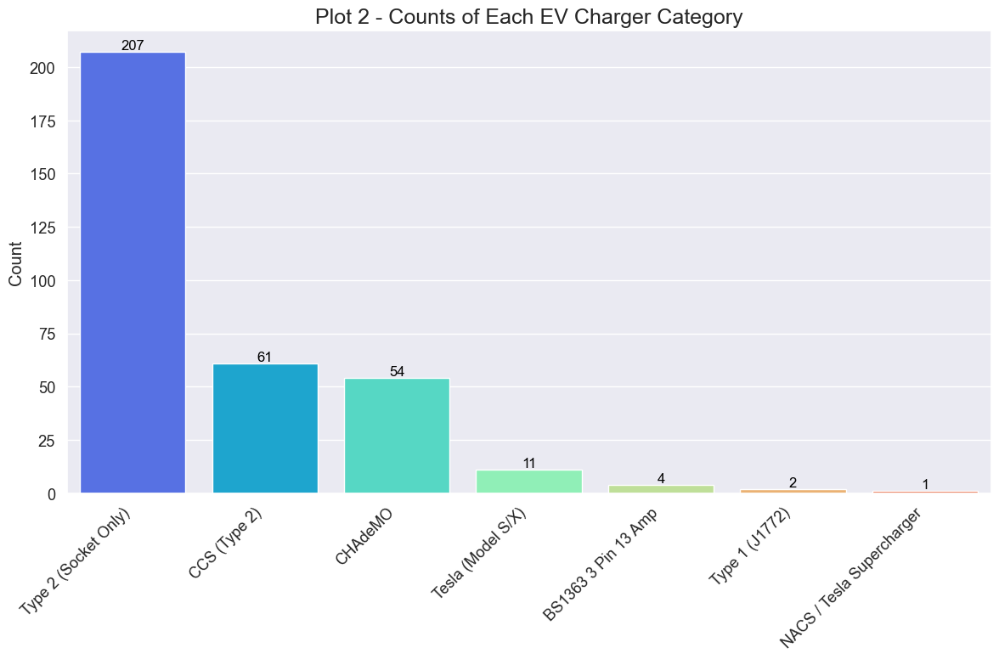

In [44]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Create a bar plot using Seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x=category_counts.index, y=category_counts, palette='rainbow')

# Add count labels on top of each bar
for index, value in enumerate(category_counts):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12, color='black')

plt.ylabel('Count')
plt.title('Plot 2 - Counts of Each EV Charger Category', fontsize=18)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [45]:
category_counts = charging_stations_final['PowerKW'].value_counts()
category_counts = category_counts.sort_values(ascending=False).head(10)

C:\Users\196sh\anaconda3\lib\site-packages\seaborn\rcmod.py:400: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

C:\Users\196sh\anaconda3\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



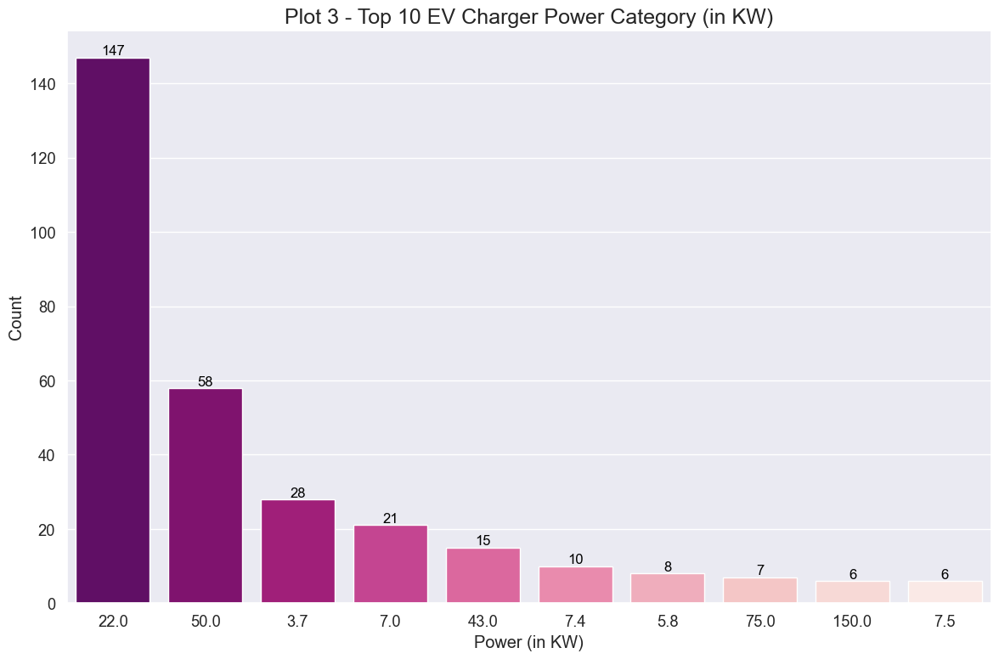

In [46]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Create a bar plot using Seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x=category_counts.index, y=category_counts, order=category_counts.index, palette='RdPu_r')

# Add count labels on top of each bar
for index, value in enumerate(category_counts):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12, color='black')

plt.ylabel('Count')
plt.xlabel('Power (in KW)')
plt.title('Plot 3 - Top 10 EV Charger Power Category (in KW)', fontsize=18)
plt.xticks(ha='center')
plt.tight_layout()
plt.show()

C:\Users\196sh\anaconda3\lib\site-packages\seaborn\rcmod.py:400: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

C:\Users\196sh\anaconda3\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



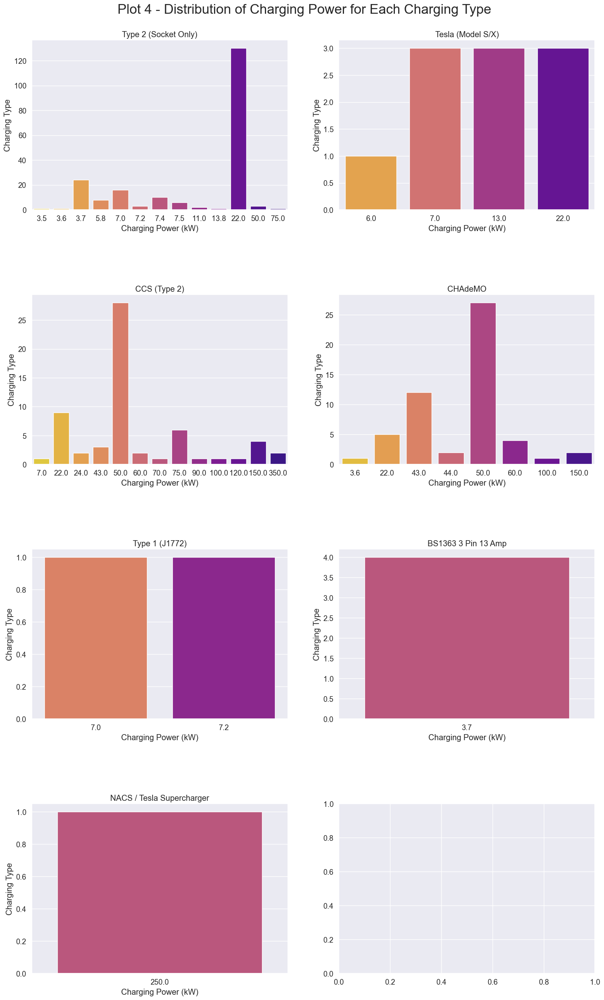

In [47]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Create a 2x3 grid of plots
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(18, 30), gridspec_kw={'hspace': 0.5})

# Reshape the axes for easy iteration
axes = axes.flatten()

# Iterate over each charging type and create a bar plot in each subplot
for i, charging_type in enumerate(charging_stations_final['Name'].unique()):
    sns.countplot(x='PowerKW', data=charging_stations_final[charging_stations_final['Name'] == charging_type], palette='plasma_r', ax=axes[i])
    axes[i].set_xlabel('Charging Power (kW)')
    axes[i].set_ylabel('Charging Type')
    axes[i].set_title(charging_type)

# Add an overall plot title
plt.suptitle('Plot 4 - Distribution of Charging Power for Each Charging Type', fontsize=24, y = 0.91)
    
plt.show()

In [48]:
# Define a dictionary to map colors to categories
color_map = {
    'Type 1 (J1772)': 'orange',
    'Type 2 (Socket Only)': 'blue',
    'CCS (Type 2)': 'red',
    'Tesla (Model S/X)': 'green',
    'CHAdeMO': 'gray',
    'BS1363 3 Pin 13 Amp': 'purple',
    'Tesla Supercharger': 'darkgreen'
}

# Create a map centered around Dublin to display the EV charging points
map_osm = folium.Map(location=[latitude, longitude], zoom_start=12)

# Add markers for each charging station location with a different marker color for different charge type
for index, row in charging_stations_final.iterrows():
    name = row['Name'] + ', ' + str(row['PowerKW']) + ' Kw, ' + row['Title'] + ', ' + row['AddressLine1'] + ', ' + str(row['Town'])
    lon = row['Longitude']
    lat = row['Latitude']
    
    category = row['Name']
    marker_color = color_map.get(category, 'gray')  # Use 'gray' if category not found in the color map

    # marker = folium.Marker(location=[lat, lon], popup=name)
    # marker = folium.CircleMarker(location=[lat, lon], radius=5, color=marker_color, fill=True, fill_color=marker_color, fill_opacity=1, popup=name)
    icon = folium.Icon(color=marker_color, icon='map-marker')  # Use the 'map-marker' icon with the specified color

    marker = folium.Marker(location=[lat, lon], icon=icon, popup=name)

    marker.add_to(map_osm)

# Display the map
map_osm

### <div style="text-align: right">[Back to top ↑](#top)</div>

## <a id='the_destination_2_3'>c) Public Service Spots in Dublin</a>

In [49]:
distance = 25000  # Radius of 30 kilometers around the location
tags = {'amenity': True}
gdf = ox.geometries_from_point(location, tags=tags, dist=distance)

C:\Users\196sh\AppData\Local\Temp\ipykernel_21384\3329640468.py:3: UserWarning:

The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.



In [50]:
public_services_tags = ['school', 'pharmacy', 'place_of_worship', 'bank', 'doctors', 'kindergarten', 'social_facility', 
                        'post_office', 'clinic', 'childcare', 'library', 'police', 'veterinary', 'nursing_home', 'post_depot', 
                        'fire_station', 'courthouse']

In [51]:
# Filter the data for the public service spots in the same 25 km radius
public_services = gdf[gdf['amenity'].isin(public_services_tags)]

In [52]:
public_services.shape

(3190, 672)

In [53]:
public_services = pd.DataFrame(public_services)

# Remove all the columns which have less than 10% of the records populated
selected_columns = public_services.columns[public_services.count() > 0.1*len(public_services)]
public_services = public_services[selected_columns]

In [54]:
public_services.shape

(3190, 24)

In [55]:
public_services.head()

amenity                   geometry  \
element_type osmid                                                   
node         243783190           police  POINT (-6.35799 53.34473)   
             254952173         pharmacy  POINT (-6.42261 53.34785)   
             263367948  social_facility  POINT (-6.42324 53.34895)   
             278018000      post_office  POINT (-6.31741 53.28286)   
             278290761         pharmacy  POINT (-6.31806 53.28300)   

                              operator operator:wikidata operator:wikipedia  \
element_type osmid                                                            
node         243783190  Garda Síochána          Q1366959  en:Garda Síochána   
             254952173             NaN               NaN                NaN   
             263367948             NaN               NaN                NaN   
             278018000         An Post           Q482490         en:An Post   
             278290761             NaN               NaN                NaN   

                       drive_through                       name  \
element_type osmid                                                
node         243783190           NaN  Ballyfermot Garda Station   
             254952173            no           Foley's Pharmacy   
             263367948           NaN                        NaN   
             278018000           NaN      Knocklyon Post Office   
             278290761            no            Lloyds Pharmacy   

                           addr:street            brand brand:wikidata  ...  \
element_type osmid                                                      ...   
node         243783190             NaN              NaN            NaN  ...   
             254952173             NaN              NaN            NaN  ...   
             263367948  Ballyowen Lane  Citizens Advice       Q5122657  ...   
             278018000   Idrone Avenue          An Post        Q482490  ...   
             278290761             NaN  Lloyds Pharmacy       Q6662870  ...   

                       addr:city                  website wheelchair  \
element_type osmid                                                     
node         243783190    Dublin                      NaN        NaN   
             254952173       NaN                      NaN        yes   
             263367948     Lucan                      NaN        NaN   
             278018000       NaN  https://www.anpost.com/        NaN   
             278290761       NaN                      NaN        NaN   

                       dispensing healthcare addr:housenumber denomination  \
element_type osmid                                                           
node         243783190        NaN        NaN              NaN          NaN   
             254952173        yes   pharmacy              NaN          NaN   
             263367948        NaN        NaN              NaN          NaN   
             278018000        NaN        NaN              NaN          NaN   
             278290761        yes   pharmacy              NaN          NaN   

                       religion building nodes  
element_type osmid                              
node         243783190      NaN      NaN   NaN  
             254952173      NaN      NaN   NaN  
             263367948      NaN      NaN   NaN  
             278018000      NaN      NaN   NaN  
             278290761      NaN      NaN   NaN  

[5 rows x 24 columns]

In [56]:
public_services.columns

Index(['amenity', 'geometry', 'operator', 'operator:wikidata',
       'operator:wikipedia', 'drive_through', 'name', 'addr:street', 'brand',
       'brand:wikidata', 'brand:wikipedia', 'email', 'opening_hours', 'phone',
       'addr:city', 'website', 'wheelchair', 'dispensing', 'healthcare',
       'addr:housenumber', 'denomination', 'religion', 'building', 'nodes'],
      dtype='object')

In [57]:
# Creating separate columns for the latitude and longitude
public_services['public_services_latitude'] = public_services['geometry'].apply(lambda point: point.y if isinstance(point, Point) else point.centroid.y)
public_services['public_services_longitude'] = public_services['geometry'].apply(lambda point: point.x if isinstance(point, Point) else point.centroid.x)

In [58]:
# Pick only the features/columns which will be useful for our analysis 
public_services_final = public_services[['public_services_latitude', 'public_services_longitude', 'amenity', 'name', 'addr:street', 'brand', 'addr:city']]

In [59]:
# Rename the column names for downstream use
public_services_final = public_services_final.rename(columns={
                                              'amenity': 'public_services_tag', 
                                              'name': 'public_services_address',
                                              'addr:street': 'public_services_street',
                                              'addr:city': 'public_services_city',
                                              'brand': 'public_services_brand_name'})

In [60]:
public_services_final.reset_index(drop=True).head()

,public_services_latitude,public_services_longitude,public_services_tag,public_services_address,public_services_street,public_services_brand_name,public_services_city
0,53.344729,-6.357992,police,Ballyfermot Garda Station,NaN,NaN,Dublin
1,53.347851,-6.422606,pharmacy,Foley's Pharmacy,NaN,NaN,NaN
2,53.348951,-6.423243,social_facility,NaN,Ballyowen Lane,Citizens Advice,Lucan
3,53.282861,-6.317409,post_office,Knocklyon Post Office,Idrone Avenue,An Post,NaN
4,53.282998,-6.318062,pharmacy,Lloyds Pharmacy,NaN,Lloyds Pharmacy,NaN


In [61]:
print("The total number of public service spots considered for our analysis is", len(public_services_final))

The total number of public service spots considered for our analysis is 3190


In [62]:
# Get the counts of each hotspot category
category_counts = public_services_final['public_services_tag'].value_counts()

C:\Users\196sh\anaconda3\lib\site-packages\seaborn\rcmod.py:400: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

C:\Users\196sh\anaconda3\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



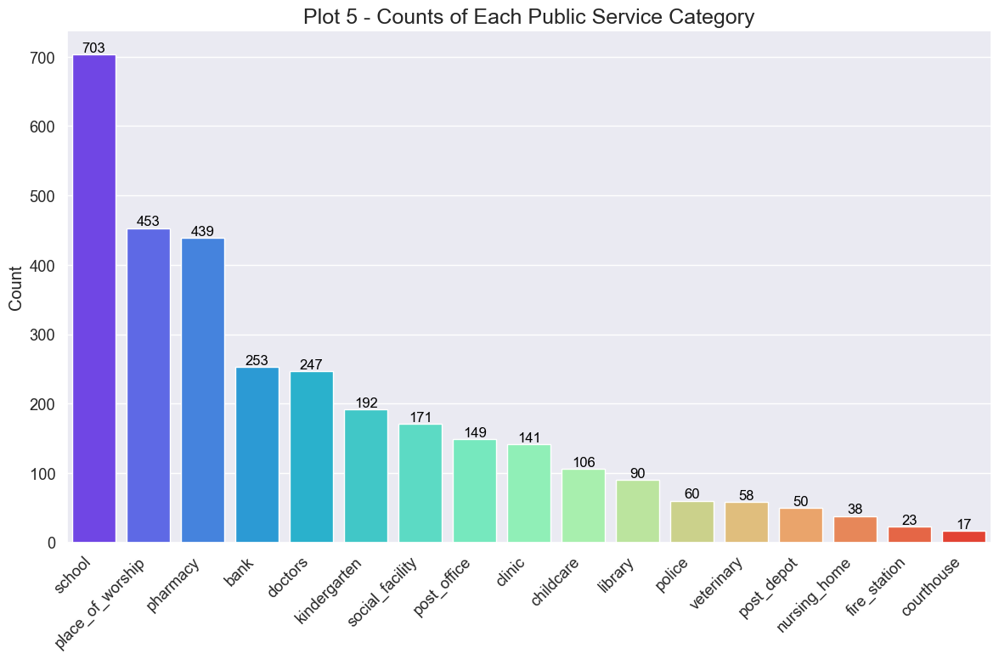

In [63]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Create a bar plot using Seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x=category_counts.index, y=category_counts, palette='rainbow')

# Add count labels on top of each bar
for index, value in enumerate(category_counts):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12, color='black')

plt.ylabel('Count')
plt.title('Plot 5 - Counts of Each Public Service Category', fontsize=18)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [64]:
# Create a map centered around Dublin
latitude = location[0]  # Latitude of the center point
longitude = location[1] # Longitude of the center point
map_osm = folium.Map(location=[latitude, longitude], zoom_start=12)
# icon = folium.Icon(icon='circle', prefix='fa', color='blue', icon_color='white', icon_size=(4, 4))

# Add markers for each public service spot
for index, spot in public_services_final.iterrows():
    name = spot['public_services_address']
    lat = spot['public_services_latitude']
    lon = spot['public_services_longitude']
    marker = folium.CircleMarker(location=[lat, lon], radius=4, popup=name, color='blue', fill=True, fill_color='blue')
    marker.add_to(map_osm)

# Display the map
map_osm

### <div style="text-align: right">[Back to top ↑](#top)</div>

## <a id='the_destination_2_4'>d) Places of Recreation and Tourist Spots in Dublin</a>

In [65]:
rec_tourist_tags = ['restaurant', 'cafe', 'pub', 'bar', 'theatre', 'arts_centre', 'cinema', 'nightclub']

In [66]:
# Filter the data for the recreational/tourist spots in the same 25 Km radius
rec_tourist_spots = gdf[gdf['amenity'].isin(rec_tourist_tags)]

In [67]:
rec_tourist_spots.shape

(3146, 672)

In [68]:
rec_tourist_spots = pd.DataFrame(rec_tourist_spots)

# Remove all the columns which have less than 10% of the records populated
selected_columns = rec_tourist_spots.columns[rec_tourist_spots.count() > 0.1*len(rec_tourist_spots)]
rec_tourist_spots = rec_tourist_spots[selected_columns]

In [69]:
rec_tourist_spots.shape

(3146, 21)

In [70]:
rec_tourist_spots.head()

amenity                   geometry  \
element_type osmid                                              
node         132814618         pub  POINT (-6.37740 53.35007)   
             133193958         pub  POINT (-6.26059 53.33055)   
             254949231      cinema  POINT (-6.39372 53.35211)   
             263366607         pub  POINT (-6.42389 53.34739)   
             278857702  restaurant  POINT (-6.26192 53.34578)   

                                     name      addr:street email  \
element_type osmid                                                 
node         132814618     Silver Granite              NaN   NaN   
             133193958      The Barge Bar  Charlemont Mall   NaN   
             254949231  Vue Cinema Dublin              NaN   NaN   
             263366607     The Penny Hill      Castle Road   NaN   
             278857702         La Gondola      Bedford Row   NaN   

                       opening_hours  \
element_type osmid                     
node         132814618           NaN   
             133193958           NaN   
             254949231           NaN   
             263366607           NaN   
             278857702           NaN   

                                                               phone  \
element_type osmid                                                     
node         132814618                                           NaN   
             133193958                                           NaN   
             254949231  https://www.myvue.com/cinema/dublin/whats-on   
             263366607                                           NaN   
             278857702                                           NaN   

                       addr:city                      contact:facebook  \
element_type osmid                                                       
node         132814618       NaN                                   NaN   
             133193958    Dublin  https://www.facebook.com/thebargeinn   
             254949231       NaN                            VueCinemas   
             263366607     Lucan                                   NaN   
             278857702    Dublin                                   NaN   

                                                             website  ...  \
element_type osmid                                                    ...   
node         132814618                                           NaN  ...   
             133193958                      https://www.thebarge.ie/  ...   
             254949231  https://www.myvue.com/cinema/dublin/whats-on  ...   
             263366607                    https://pennyhilllucan.ie/  ...   
             278857702                     https://www.lagondola.ie/  ...   

                       addr:country addr:county addr:postcode  \
element_type osmid                                              
node         132814618          NaN         NaN           NaN   
             133193958          NaN         NaN           NaN   
             254949231          NaN         NaN           NaN   
             263366607           IE      Dublin      K78 Y6P9   
             278857702          NaN         NaN           NaN   

                       addr:housenumber  cuisine takeaway smoking  \
element_type osmid                                                  
node         132814618              NaN      NaN      NaN     NaN   
             133193958              NaN      NaN      NaN     NaN   
             254949231              NaN      NaN      NaN     NaN   
             263366607              NaN      NaN      NaN     NaN   
             278857702              NaN  italian      NaN     NaN   

                       outdoor_seating building nodes  
element_type osmid                                     
node         132814618             NaN      NaN   NaN  
             133193958             NaN      NaN   NaN  
             254949231             NaN      NaN   NaN  
             263366607       

In [71]:
rec_tourist_spots.columns

Index(['amenity', 'geometry', 'name', 'addr:street', 'email', 'opening_hours',
       'phone', 'addr:city', 'contact:facebook', 'website', 'wheelchair',
       'addr:country', 'addr:county', 'addr:postcode', 'addr:housenumber',
       'cuisine', 'takeaway', 'smoking', 'outdoor_seating', 'building',
       'nodes'],
      dtype='object')

In [72]:
# Creating separate columns for the latitude and longitude
rec_tourist_spots['rec_tourist_spots_latitude'] = rec_tourist_spots['geometry'].apply(lambda point: point.y if isinstance(point, Point) else point.centroid.y)
rec_tourist_spots['rec_tourist_spots_longitude'] = rec_tourist_spots['geometry'].apply(lambda point: point.x if isinstance(point, Point) else point.centroid.x)

In [73]:
# Pick only the features/columns which will be useful for our analysis 
rec_tourist_spots_final = rec_tourist_spots[['rec_tourist_spots_latitude', 'rec_tourist_spots_longitude', 'amenity', 'name', 'addr:street', 'addr:city']]

In [74]:
# Rename the column names for downstream use
rec_tourist_spots_final = rec_tourist_spots_final.rename(columns={
                                              'amenity': 'rec_tourist_spots_tag', 
                                              'name': 'rec_tourist_spots_address',
                                              'addr:street': 'rec_tourist_spots_street',
                                              'addr:city': 'rec_tourist_spots_city'})

In [75]:
rec_tourist_spots_final.reset_index(drop=True).head()

,rec_tourist_spots_latitude,rec_tourist_spots_longitude,rec_tourist_spots_tag,rec_tourist_spots_address,rec_tourist_spots_street,rec_tourist_spots_city
0,53.350075,-6.377403,pub,Silver Granite,NaN,NaN
1,53.330551,-6.260588,pub,The Barge Bar,Charlemont Mall,Dublin
2,53.352109,-6.393719,cinema,Vue Cinema Dublin,NaN,NaN
3,53.347390,-6.423887,pub,The Penny Hill,Castle Road,Lucan
4,53.345784,-6.261924,restaurant,La Gondola,Bedford Row,Dublin


In [76]:
print("The total number of recreational places and tourist spots considered for our analysis is", len(rec_tourist_spots_final))

The total number of recreational places and tourist spots considered for our analysis is 3146


In [77]:
# Get the counts of each hotspot category
category_counts = rec_tourist_spots_final['rec_tourist_spots_tag'].value_counts()

C:\Users\196sh\anaconda3\lib\site-packages\seaborn\rcmod.py:400: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

C:\Users\196sh\anaconda3\lib\site-packages\setuptools\_distutils\version.py:346: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



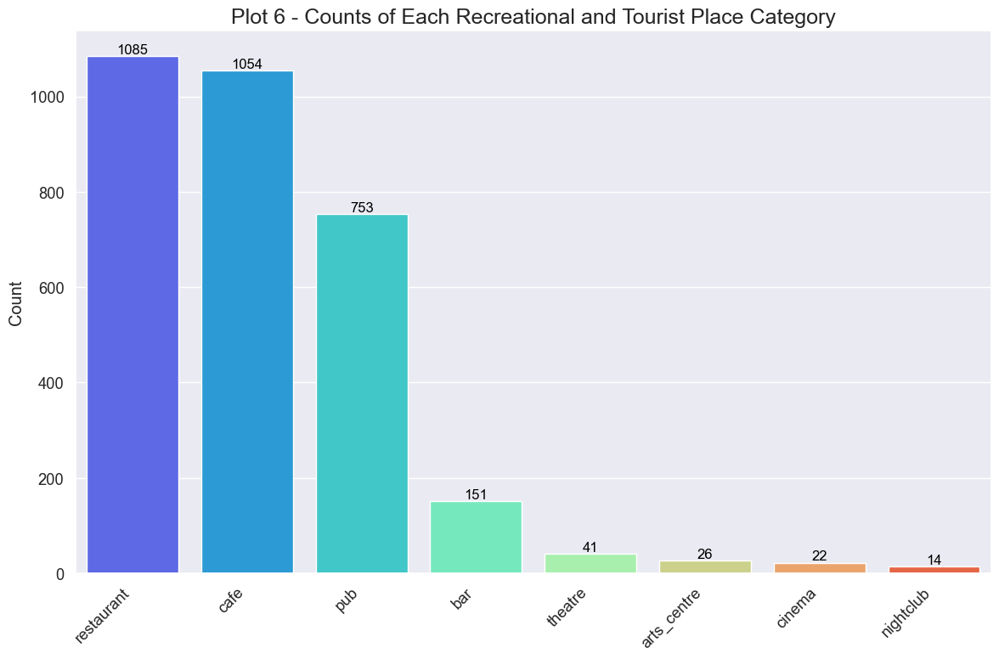

In [78]:
# Set the Seaborn style
sns.set(style='darkgrid', font_scale=1.2)

# Create a bar plot using Seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x=category_counts.index, y=category_counts, palette='rainbow')

# Add count labels on top of each bar
for index, value in enumerate(category_counts):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12, color='black')

plt.ylabel('Count')
plt.title('Plot 6 - Counts of Each Recreational and Tourist Place Category', fontsize=18)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [79]:
# Create a map centered around Dublin
latitude = location[0]  # Latitude of the center point
longitude = location[1] # Longitude of the center point
map_osm = folium.Map(location=[latitude, longitude], zoom_start=12)
# icon = folium.Icon(icon='circle', prefix='fa', color='blue', icon_color='white', icon_size=(4, 4))

# Add markers for each recreational place and tourist spot
for index, spot in rec_tourist_spots_final.iterrows():
    name = spot['rec_tourist_spots_address']
    lat = spot['rec_tourist_spots_latitude']
    lon = spot['rec_tourist_spots_longitude']
    marker = folium.CircleMarker(location=[lat, lon], radius=4, popup=name, color='purple', fill=True, fill_color='purple')
    marker.add_to(map_osm)

# Display the map
map_osm

### <div style="text-align: right">[Back to top ↑](#top)</div>

## <a id='the_destination_2_5'>e) Pobal's HP Deprivation Index for Dublin at a District level</a>

In [80]:
df = pd.read_csv("E:\\MSCDAD_JAN23A\\SEM II\\RIC\\Ireland EV prediction data\\Dublin\\HP-Index-2006-2016-HP-Index-Scores-by-ID06b2.csv", encoding= 'unicode_escape')

In [81]:
df.shape

(3409, 64)

In [82]:
df.head()

,ID06,ED_Name,NUTS4,NUTS3,NUTS2,NUTS1,HP2006abs,HP2011abs,HP2016abs,HP2006rel,...,PEROOM16,LARENT06,LARENT11,LARENT16,PRRENT06,PRRENT11,PRRENT16,OHOUSE06,OHOUSE11,OHOUSE16
0,1001,CARLOW URBAN/RURAL (PT.),Carlow,South East,Southern & Eastern Region,Ireland,-10.3,-15.6,-12.5,-10.3,...,0.5,13.7,15.5,19.1,30.1,35.4,35.0,54.3,47.7,43.6
1,1002,GRAIGUE URBAN,Carlow,South East,Southern & Eastern Region,Ireland,-12.3,-18.6,-13.8,-12.3,...,0.5,8.9,12.0,15.9,27.1,23.6,20.7,62.3,62.8,61.0
2,1003,CLONMORE,Carlow,South East,Southern & Eastern Region,Ireland,-3.2,-8.4,-5.5,-3.2,...,0.5,0.0,1.1,1.1,1.2,4.5,5.1,98.2,91.7,92.1
3,1004,HACKETSTOWN,Carlow,South East,Southern & Eastern Region,Ireland,-9.5,-16.6,-14.7,-9.5,...,0.5,11.0,13.8,16.5,7.4,9.3,8.8,79.7,75.8,73.2
4,1005,HAROLDSTOWN,Carlow,South East,Southern & Eastern Region,Ireland,-1.4,-13.2,-9.1,-1.4,...,0.5,0.0,0.0,1.0,4.7,3.4,3.1,93.0,95.5,93.8


As you can see, the data is collected at the enumerative district level, which provides a highly detailed and granular view of the information. This level of granularity allows us to accurately map each hotspot to its corresponding enumerative district and obtain the specific information relevant to that particular hotspot. Utilizing data at such a fine-grained level ensures that we can address the situation at each hotspot with precision and accuracy, avoiding any generalizations or overlooking critical details that might be lost when using data at a higher level of granularity. By analyzing the data at the enumerative district level, we can gain valuable insights into the unique characteristics and challenges faced by individual hotspots, enabling targeted and effective interventions to address their specific needs.

In [83]:
# Filtering only for Dublin since our analysis is focused here
dublin_df = df[df["NUTS3"] == "Dublin"]

In [84]:
dublin_df.shape

(322, 64)

In [85]:
dublin_df.head()

,ID06,ED_Name,NUTS4,NUTS3,NUTS2,NUTS1,HP2006abs,HP2011abs,HP2016abs,HP2006rel,...,PEROOM16,LARENT06,LARENT11,LARENT16,PRRENT06,PRRENT11,PRRENT16,OHOUSE06,OHOUSE11,OHOUSE16
54,2001,ARRAN QUAY A,Dublin City,Dublin,Southern & Eastern Region,Ireland,3.3,-2.6,1.0,3.3,...,0.6,11.3,10.1,12.8,45.7,55.2,53.6,41.5,32.5,31.9
55,2002,ARRAN QUAY B,Dublin City,Dublin,Southern & Eastern Region,Ireland,3.6,-0.3,1.9,3.6,...,0.8,11.0,10.3,13.9,59.4,66.8,64.6,28.7,22.1,20.4
56,2003,ARRAN QUAY C,Dublin City,Dublin,Southern & Eastern Region,Ireland,9.1,5.3,6.0,9.1,...,1.0,15.5,13.6,14.6,63.5,72.3,71.2,20.3,13.5,13.6
57,2004,ARRAN QUAY D,Dublin City,Dublin,Southern & Eastern Region,Ireland,-6.4,-6.8,-0.3,-6.4,...,0.9,29.5,20.9,14.2,30.9,42.4,44.9,38.8,35.8,39.3
58,2005,ARRAN QUAY E,Dublin City,Dublin,Southern & Eastern Region,Ireland,-0.3,-3.6,1.8,-0.3,...,0.5,12.9,11.8,13.4,31.8,44.9,46.9,54.3,41.9,38.1


In [86]:
pd.set_option('display.max_rows', None)

In [87]:
pd.reset_option('display.max_rows')

In [88]:
# Filtering for only those features that are relevant for our analysis
final_df = dublin_df[["ID06", "ED_Name", "NUTS4", "NUTS2", "NUTS1", "HP2016rel", "TOTPOP16"]].reset_index(drop=True)

In [89]:
# Rename the column names for downstream use
final_df = final_df.rename(columns={'ID06': 'id', 
                                    'ED_Name': 'name',
                                    'NUTS4': 'county',
                                    'NUTS2': 'region',
                                    'NUTS1': 'country',
                                    'HP2016rel': 'hp_index_2016',
                                    'TOTPOP16': 'total_population_2016'})

In [90]:
# Convert the population data from string to integer
final_df['total_population_2016'] = final_df['total_population_2016'].str.replace(',', '').astype(int)

In [91]:
final_df.head()

,id,name,county,region,country,hp_index_2016,total_population_2016
0,2001,ARRAN QUAY A,Dublin City,Southern & Eastern Region,Ireland,6.7,1785
1,2002,ARRAN QUAY B,Dublin City,Southern & Eastern Region,Ireland,7.6,4166
2,2003,ARRAN QUAY C,Dublin City,Southern & Eastern Region,Ireland,11.9,4471
3,2004,ARRAN QUAY D,Dublin City,Southern & Eastern Region,Ireland,4.8,3109
4,2005,ARRAN QUAY E,Dublin City,Southern & Eastern Region,Ireland,6.8,3293


In [92]:
warnings.filterwarnings('ignore')

# Sort the data by the index in ascending order for a better visualization
final_df = final_df.sort_values(by='hp_index_2016', ascending=True)

# Create the interactive bar plot using Plotly
fig = px.bar(final_df, x='hp_index_2016', y='name', orientation='h', 
             text='hp_index_2016', color='hp_index_2016', 
             color_continuous_scale='viridis', range_color=(-1, 1))

# Add labels and titles
fig.update_layout(title=" Plot 7 - Interactive Plot of Pobal's Deprivation Index for Enumerative Districts",
                  xaxis_title='Pobal Deprivation Index',
                  yaxis_title='Enumerative District',
                  showlegend=False,
                  height=1000,  
                  width=900)

# Show the plot
fig.show()

In [94]:
warnings.filterwarnings('ignore')

geo_df = gpd.read_file(".\CSO_Electoral_Divisions_Generalised_100m.geojson")

In [95]:
geo_df.head()

,OBJECTID_1,ED_ID,ED_ENGLISH,ED_GAEILGE,COUNTY,CONTAE,PROVINCE,CENTROID_X,CENTROID_Y,GUID_,CSOED_3409,OSIED_3441,CSOED_34_1,Shape__Area,Shape__Length,geometry
0,1,47033,BALLYMODAN,,CORK,Corcaigh,Munster,547718.261772674,553339.455581436,2AE196291F5013A3E055000000000001,18013,47033,Ballymodan,2.855979e+07,29579.777814,"POLYGON ((-8.69830 51.73374, -8.70735 51.73519..."
1,2,97055,KILBEACON,Cill Bhéacáin,KILKENNY,Cill Chainnigh,Leinster,657681.211216703,627000.862373916,2AE19629240313A3E055000000000001,07103,97055,Kilbeacon,1.323008e+07,15936.240574,"POLYGON ((-7.12795 52.40352, -7.12056 52.40202..."
2,3,128014,DOCK A,An Duga A,LIMERICK,Luimneach,Munster,557059.535581243,656662.074900637,2AE1962917E613A3E055000000000001,20014,128014,Dock A,1.435421e+05,1537.811257,"POLYGON ((-8.63056 52.66019, -8.63432 52.65690..."
3,4,47208,KILMALODA WEST,,CORK,Corcaigh,Munster,542522.122127034,547639.394685899,2AE1962921D313A3E055000000000001,18066,47208,Kilmaloda West,1.171043e+07,20133.175881,"POLYGON ((-8.80053 51.70032, -8.79691 51.68625..."
4,5,217114,KILVEMNON,Cill Mheanmnáin,TIPPERARY,Tiobraid Árann,Munster,635998.202174985,637668.902395454,2AE196291C1F13A3E055000000000001,23148,217114,Kilvemnon,1.828615e+07,25682.974108,"MULTIPOLYGON (((-7.45318 52.46012, -7.46023 52..."


In [96]:
# Updating the names for a few places as they are slightly different between the 2 datasets
update_values = {
    'CARNA': 'CHERRY ORCHARD B (CARNA)',
    'DALKEY UPPER': 'DALKEY-UPPER',
    'DUN LAOGHAIRE SALLYNOGGIN EAST': 'DUN LAOGHAIRE-SALLYNOGIN EAST',
    'DUN LAOGHAIRE-SALLYNOGGIN WEST': 'DUN LAOGHAIRE-SALLYNOGIN WEST',
    'DUN LAOGHAIRE SALLYNOGGIN SOUTH': 'DUN LAOGHAIRE-SALLYNOGIN SOUTH',
    'FOXROCK-DEANSGRANGE': 'FOXROCK-DEANS GRANGE',
    'KILLINEY NORTH': 'KILLINEY-NORTH',
    'KILLINEY SOUTH': 'KILLINEY-SOUTH',
    "LUCAN-St. HELENS": "LUCAN-ST. HELENS",
    'RAHENY-St. ASSAM': 'RAHENY-ST.ASSAM',
    "RATHFARNHAM-St. ENDA'S": "RATHFARNHAM-ST. ENDA'S",
    "SAINT KEVIN'S": "ST KEVIN'S",
    "TERENURE-St. JAMES": "TERENURE-ST. JAMES"
}

geo_df['ED_ENGLISH'].replace(update_values, inplace=True)

In [97]:
# Merge the GeoDataFrame with the DataFrame based on the district name
merged_df = final_df.merge(geo_df, left_on='name', right_on='ED_ENGLISH', how='left')

In [98]:
merged_df.head()

,id,name,county,region,country,hp_index_2016,total_population_2016,OBJECTID_1,ED_ID,ED_ENGLISH,...,PROVINCE,CENTROID_X,CENTROID_Y,GUID_,CSOED_3409,OSIED_3441,CSOED_34_1,Shape__Area,Shape__Length,geometry
0,2081,PRIORSWOOD B,Dublin City,Southern & Eastern Region,Ireland,-21.6,2728,472.0,268122,PRIORSWOOD B,...,Leinster,719735.839433726,740798.597623558,2AE196291DCD13A3E055000000000001,02081,268122,Priorswood B,516605.240112,2973.683033,"POLYGON ((-6.19483 53.40724, -6.19411 53.39898..."
1,2056,FINGLAS SOUTH C,Dublin City,Southern & Eastern Region,Ireland,-20.3,2645,1494.0,268068,FINGLAS SOUTH C,...,Leinster,712628.167327125,738132.575244068,2AE196291D6F13A3E055000000000001,02056,268068,Finglas South C,390636.659485,2767.373955,"POLYGON ((-6.30583 53.37665, -6.31097 53.37812..."
2,3033,TALLAGHT-KILLINARDAN,South County Dublin,Southern & Eastern Region,Ireland,-19.5,3958,2016.0,267141,TALLAGHT-KILLINARDAN,...,Leinster,707568.803650832,726390.172278041,2AE196291CB813A3E055000000000001,03033,267141,Tallaght-Killinardan,734130.630676,3507.944887,"POLYGON ((-6.37899 53.27682, -6.37985 53.27393..."
3,2071,KILMORE C,Dublin City,Southern & Eastern Region,Ireland,-18.9,1490,1693.0,268086,KILMORE C,...,Leinster,719360.082648742,739708.995641085,2AE196291D8E13A3E055000000000001,02071,268086,Kilmore C,308585.751892,3114.576314,"POLYGON ((-6.19579 53.38992, -6.21508 53.39609..."
4,3028,TALLAGHT-AVONBEG,South County Dublin,Southern & Eastern Region,Ireland,-17.6,1538,1695.0,267136,TALLAGHT-AVONBEG,...,Leinster,710271.242469352,727384.830255367,2AE196291CB313A3E055000000000001,03028,267136,Tallaght-Avonbeg,259168.492889,2503.995711,"POLYGON ((-6.34674 53.28198, -6.35306 53.28576..."


In [99]:
merged_df['name'].head()

0            PRIORSWOOD B
1         FINGLAS SOUTH C
2    TALLAGHT-KILLINARDAN
3               KILMORE C
4        TALLAGHT-AVONBEG
Name: name, dtype: object

In [100]:
# Delete rows with null values
merged_df.dropna(inplace=True)

In [101]:
merged_df.to_csv('Final_Merged.csv', index=False)

In [102]:
warnings.filterwarnings('ignore')

# Convert ITM coordinates to latitude and longitude
def convert_itm_to_latlon(x, y):
    itm_proj = pyproj.Proj(init='epsg:2157')  # EPSG code for Irish Transverse Mercator (ITM)
    wgs84_proj = pyproj.Proj(init='epsg:4326')  # EPSG code for WGS84 (latitude and longitude)

    lon, lat = pyproj.transform(itm_proj, wgs84_proj, x, y)
    return lat, lon

merged_df['latitude'], merged_df['longitude'] = zip(*merged_df.apply(lambda row: convert_itm_to_latlon(row['CENTROID_X'], row['CENTROID_Y']), axis=1))

# function to determine the color based on the 'hp_index_2016' value
def get_color(hp_index):
    if hp_index > 30:
        return 'grey'
    elif hp_index > 20:
        return 'purple'
    elif hp_index > 10:
        return 'darkblue'
    elif hp_index > 0:
        return 'blue'
    elif hp_index > -10:
        return 'orange'
    elif hp_index > -20:
        return 'darkorange'
    elif hp_index > -30:
        return 'red'
    else:
        return 'darkred'

# Create a folium map using the OpenStreetMap tile provider
# Using Priorswood's location as the center as it aligns the map perfectly for viewing
map_center = [merged_df[merged_df['name'] == 'PRIORSWOOD B']['latitude'],
              merged_df[merged_df['name'] == 'PRIORSWOOD B']['longitude']]
mymap = folium.Map(location=map_center, zoom_start=10.2, tiles='OpenStreetMap')

# Add polygons for each district with custom style options for clear boundaries and color based on 'color' column
for idx, row in merged_df.iterrows():
    idx = row['hp_index_2016']
    folium.GeoJson(data=row['geometry'], name=row['name'], style_function = lambda x, idx=idx: {
                'fillColor': get_color(idx),
                'color': get_color(idx),
                'weight': 1.5,
                'fillOpacity': 0.7}, 
                   tooltip= row['name'] + ": " + str(row['hp_index_2016'])).add_to(mymap) 

# Create a linear colormap legend
legend_color_scale = folium.StepColormap(
    colors=['darkred', 'red', 'darkorange', 'orange','blue', 'darkblue', 'purple'],
    vmin=merged_df['hp_index_2016'].min(),
    vmax=merged_df['hp_index_2016'].max(),
    index=[-30, -20, -10, 0, 10, 20, 30],
    caption='HP Index (2016)'
)

# Add the legend to the map
mymap.add_child(legend_color_scale)    

# Display the map
mymap

### <div style="text-align: right">[Back to top ↑](#top)</div>

## <a id='the_destination_2_6'>f) Total Population of Dublin at a District level</a>

In [103]:
warnings.filterwarnings('ignore')

# Sort the data by the index in ascending order for a better visualization
final_df = final_df.sort_values(by='total_population_2016', ascending=True)

# Create the interactive bar plot using Plotly
fig = px.bar(final_df, x='total_population_2016', y='name', orientation='h', 
             text='total_population_2016', color='total_population_2016', 
             color_continuous_scale='viridis', range_color=(0, 40000))

# Add labels and titles
fig.update_layout(title=" Plot 8 - Interactive Plot of Total Population for Enumerative Districts",
                  xaxis_title='Total Population',
                  yaxis_title='Enumerative District',
                  showlegend=False,
                  height=1000,  
                  width=900)

# Show the plot
fig.show()

In [104]:
mymap = folium.Map(location=map_center, zoom_start=10.2, tiles='OpenStreetMap')

# Define the color scale (adjust the colors as desired)
color_scale = folium.StepColormap(
    colors=['darkred', 'red', 'darkorange', 'orange', 'lightgreen', 'darkgreen'],
    vmin=merged_df['total_population_2016'].min(),
    vmax=merged_df['total_population_2016'].max(),
    index=[0, 5000, 10000, 15000, 20000, 40000],
    caption='Total Population (2016)'
)

# Function to determine the color based on the 'total_population_2016' value
def get_color(population):
    return color_scale(population)

# Add polygons for each district with custom style options for clear boundaries and color based on 'total_population_2016' column
for idx, row in merged_df.iterrows():
    population = row['total_population_2016']
    folium.GeoJson(
        data=row['geometry'],
        name=row['name'],
        style_function=lambda x, population=population: {
            'fillColor': get_color(population),
            'color': get_color(population),
            'weight': 1.5,
            'fillOpacity': 0.7
        },
        tooltip=row['name'] + ": " + str(population)
    ).add_to(mymap)

# Add legend for the color scale
mymap.add_child(color_scale)

# Display the map
mymap

### <div style="text-align: right">[Back to top ↑](#top)</div>